In [1]:
import requests
import urllib
import pandas as pd
import matplotlib.pyplot as plt

from matplotlib import font_manager


In [1]:
outputpath = "./NgramViewer/"

with open('./wordlist/dict_threat.txt','r') as f:
    dict_threat = f.read().splitlines()
with open('./wordlist/dict_indi.txt','r') as f:
    dict_indi = f.read().splitlines()
with open('./wordlist/dict_coll.txt','r') as f:
    dict_coll = f.read().splitlines()
with open('./wordlist/dict_loose.txt','r') as f:
    dict_loose = f.read().splitlines()
with open('./wordlist/dict_tight.txt','r') as f:
    dict_tight = f.read().splitlines()

# with open('./wordlist/dict_suffer.txt','r') as f:
#     dict_suffer = f.read().splitlines()
# with open('./wordlist/dict_pure.txt','r') as f:
#     dict_pure = f.read().splitlines()
# with open('./wordlist/dict_abstin.txt','r') as f:
#     dict_abstin = f.read().splitlines()
# # dicts = {'High_Competence': dict_hcomp, 'Low_C

with open('./wordlist/care_vic.txt','r') as f:
    care_vic = f.read().splitlines()
with open('./wordlist/care_vir.txt','r') as f:
    care_vir = f.read().splitlines()
with open('./wordlist/fare_vir.txt','r') as f:
    fare_vir = f.read().splitlines()
with open('./wordlist/fare_vic.txt','r') as f:
    fare_vic = f.read().splitlines()
with open('./wordlist/loya_vir.txt','r') as f:
    loya_vir = f.read().splitlines()
with open('./wordlist/loya_vic.txt','r') as f:
    loya_vic = f.read().splitlines()
with open('./wordlist/auth_vir.txt','r') as f:
    auth_vir = f.read().splitlines()
with open('./wordlist/auth_vic.txt','r') as f:
    auth_vic = f.read().splitlines()
with open('./wordlist/sanc_vir.txt','r') as f:
    sanc_vir = f.read().splitlines()
with open('./wordlist/sanc_vic.txt','r') as f:
    sanc_vic = f.read().splitlines()

with open('./wordlist/dict_eudo.txt','r') as f:
    dict_euda = f.read().splitlines()

with open('./wordlist/dict_effort.txt','r') as f:
    dict_effort = f.read().splitlines()

with open('./wordlist/dict_effi.txt','r') as f:
    dict_effici = f.read().splitlines()
with open('./wordlist/effort_chi.txt','r') as f:
    dict_effort_chi = f.read().splitlines()

with open('./wordlist/efficiency_chi.txt','r') as f:
    dict_effici_chi = f.read().splitlines()

    
# with open('./wordlist/dict_suffer_chi.txt','r') as f:
#     dict_suffer_chi = f.read().splitlines()
# with open('./wordlist/dict_abstin_chi.txt','r') as f:
#     dict_abstin_chi = f.read().splitlines()
# with open('./wordlist/dict_pure_chi.txt','r') as f:
#     dict_pure_chi = f.read().splitlines()
    
with open('./wordlist/dict_tight_chi.txt','r') as f:
    dict_tight_chi = f.read().splitlines()
with open('./wordlist/dict_loose_chi.txt','r') as f:
    dict_loose_chi = f.read().splitlines()
with open('./wordlist/dict_coll_chi.txt','r') as f:
    dict_coll_chi = f.read().splitlines()
with open('./wordlist/dict_indi_chi.txt','r') as f:
    dict_indi_chi = f.read().splitlines()

In [5]:
# check duplicates between dict_loose_chi and dict_indi_chi
print("loose: ",dict_loose_chi)
print("indi: ",dict_indi_chi)
print("duplicate: ", set(dict_loose_chi).intersection(dict_indi_chi))


print("tight: ",dict_tight_chi)
print("coll: ",dict_coll_chi)
print("duplicate: ", set(dict_tight_chi).intersection(dict_coll_chi))

loose:  ['多元', '个性', '余地', '变革', '定制', '赋权', '各种各样', '适应', '无限', '自治', '开放', '调整', '鼓励', '变化', '自由', '主观', '允许', '灵活', '创造', '胸襟开阔']
indi:  ['选择', '竞争', '获取', '私家', '自主', '天赋', '创新', '公平']
duplicate:  set()
tight:  ['抑制', '防止', '遵守', '约束', '统一', '坚持', '执行', '禁止', '服从', '命令', '限制', '强迫', '维持', '阻碍', '迫使', '禁止', '局限', '治理', '阻止', '排除']
coll:  ['义务', '分配', '付出', '公家', '服从', '刻苦', '帮助', '牺牲']
duplicate:  {'服从'}


In [2]:
# check duplicates between dict_loose and dict_indi
print("loose: ",dict_loose)
print("indi: ",dict_indi)
print("duplicate: ", set(dict_loose).intersection(dict_indi))

print("tight: ",dict_tight)
print("coll: ",dict_coll)
print("duplicate: ", set(dict_tight).intersection(dict_coll))

loose:  ['allow', 'freedom', 'create', 'variability', 'autonomy', 'openness', 'leeway', 'flexibility', 'broadmindedness', 'transformatory', 'customize', 'subjectivities', 'modify', 'limitless', 'empower', 'adaptiveness', 'pluralism', 'personalize', 'encourage', 'diverse']
indi:  ['urban', 'choose', 'get', 'feel', 'individual', 'self', 'unique', 'child']
duplicate:  set()
tight:  ['restrain', 'prevent', 'comply', 'constrain', 'uniformity', 'adhere', 'enforce', 'proscribe', 'abide', 'dictate', 'circumscribe', 'impose', 'uphold', 'discourage', 'compel', 'forbid', 'confine', 'govern', 'prohibit', 'preclude']
coll:  ['rural', 'obliged', 'give', 'act', 'obedience', 'authority', 'belong', 'pray']
duplicate:  set()


In [3]:
def runQuery(query, start_year=1800, 
             end_year=2020, corpus=None,
             smoothing=0):
      
    # converting a regular string to 
    # the standard URL format
    # eg: "geeks for,geeks" will
    # convert to "geeks%20for%2Cgeeks"
    query = urllib.parse.quote(query)
  
    # creating the URL
    url = 'https://books.google.com/ngrams/json?content=' + query +'&year_start=' + str(start_year) + '&year_end=' + str(end_year) + '&corpus=' + str(corpus) + '&smoothing=' +str(smoothing) + ''
  
    # requesting data from the above url
    response = requests.get(url)
  
    # extracting the json data from the response we got
    output = response.json()
  
    # creating a list to store the ngram data
    return_data = []
  
    if len(output) == 0:
        # if no data returned from site,
        # print the following statement
        return "No data available for this Ngram."
    else:
        # if data returned from site,
        # store the data in return_data list
        for num in range(len(output)):
            
              # getting the name
            return_data.append((output[num]['ngram'], 
                                  
                                # getting ngram data
                                output[num]['timeseries']) 
                               )
  
    return return_data

def save_plot(query,eventyears,savename=None, corpusname = 'EngAll'):
    '''
    query: a string split by comma, e.g., "Albert Einstein,suffer"
    eventyears: verticle lines on the graph
    courpus: EngAll = 26, EngAme = 28, ChiSim = 34
    '''
    colnames = query.replace(' ','').split(',')
    
    if corpusname == "ChiSim":
        plt.rcParams['font.sans-serif'] = ['SimHei'] 
        startyear = 1950
        corpusnum = 34
    elif corpusname == "EngAll":
        startyear = 1800
        corpusnum = 26
    elif corpusname == "EngAme":
        startyear = 1800
        corpusnum = 28
    else:
        startyear = 1800
        corpusnum = 26
    print(corpusnum)
    df = pd.DataFrame(list(range(startyear,2020)),columns = ['year'])
    getNgram = runQuery(query, start_year=startyear, 
             end_year=2020, corpus=corpusnum,
             smoothing=3)
    for i in getNgram:
        df[i[0]] = i[1]
        plt.figure()
        plt.plot(df['year'], df[i[0]],label = i[0])
        plt.xlabel("Year")
        plt.legend()
        for eventyear in eventyears:  
            plt.axvline(eventyear, color="blue", linestyle="--")
        
        plt.savefig(outputpath+i[0]+'_freq.jpg')
    df['mean'] = df[df.columns[1:]].mean(axis = 1)
    plt.figure(figsize=(20, 10))
    # plt.xlabel("Year")
    plt.plot(df['year'], df['mean'],label = 'mean')
    plt.title(savename)
    plt.xlabel("Year")
    for eventyear in eventyears:
        plt.axvline(eventyear, color="blue", linestyle="--")
    plt.legend()
    if savename == None:
        plt.savefig(outputpath+"_".join(colnames)+'_mean.jpg')    
    else:
        plt.savefig(outputpath+savename+'_mean.jpg')
    
    plt.figure(figsize=(20, 10))
    # plt.xlabel("Year")
    for col in df.columns[1:]: #skip year column
        plt.plot(df['year'], df[col], label = col)   
    for eventyear in eventyears:
        plt.axvline(eventyear, color="blue", linestyle="--")
    plt.legend()    
    # if savename == None:
    #     continue
    # else:
    plt.savefig(outputpath+savename+"_"+corpusname+'.jpg')    
    df.to_csv(outputpath+savename+"_"+corpusname+".csv")
    
    return df

34


/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 20041 (\N{CJK UNIFIED IDEOGRAPH-4E49}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 21153 (\N{CJK UNIFIED IDEOGRAPH-52A1}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 20998 (\N{CJK UNIFIED IDEOGRAPH-5206}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 37197 (\N{CJK UNIFIED IDEOGRAPH-914D}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 20184 (\N{CJK UNIFIED IDEOGRAPH-4ED8}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 20986 (\N{CJK UNIFIED IDEOGRAPH-51FA}) missing from current font.
  plt.savefig(outputpath+i[0]

34


/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 36873 (\N{CJK UNIFIED IDEOGRAPH-9009}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 25321 (\N{CJK UNIFIED IDEOGRAPH-62E9}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 31454 (\N{CJK UNIFIED IDEOGRAPH-7ADE}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 20105 (\N{CJK UNIFIED IDEOGRAPH-4E89}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 33719 (\N{CJK UNIFIED IDEOGRAPH-83B7}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/3894885982.py:76: UserWarning: Glyph 21462 (\N{CJK UNIFIED IDEOGRAPH-53D6}) missing from current font.
  plt.savefig(outputpath+i[0]

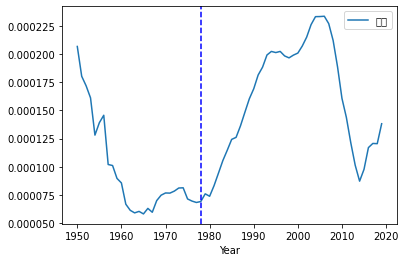

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20998 (\N{CJK UNIFIED IDEOGRAPH-5206}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 37197 (\N{CJK UNIFIED IDEOGRAPH-914D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


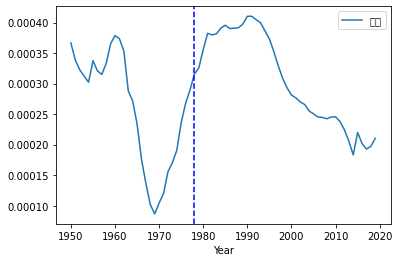

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20184 (\N{CJK UNIFIED IDEOGRAPH-4ED8}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20986 (\N{CJK UNIFIED IDEOGRAPH-51FA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


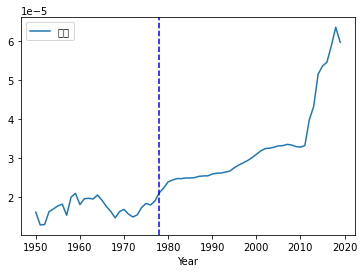

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20844 (\N{CJK UNIFIED IDEOGRAPH-516C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 23478 (\N{CJK UNIFIED IDEOGRAPH-5BB6}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


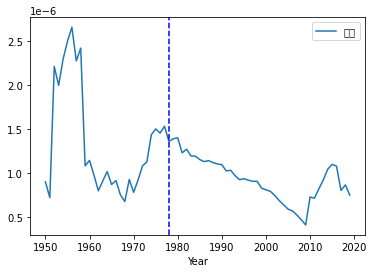

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26381 (\N{CJK UNIFIED IDEOGRAPH-670D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20174 (\N{CJK UNIFIED IDEOGRAPH-4ECE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


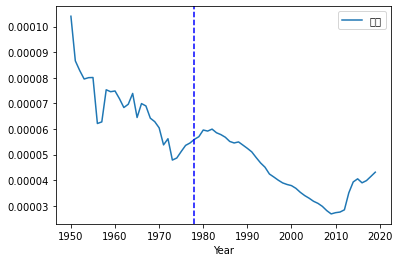

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21051 (\N{CJK UNIFIED IDEOGRAPH-523B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 33510 (\N{CJK UNIFIED IDEOGRAPH-82E6}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


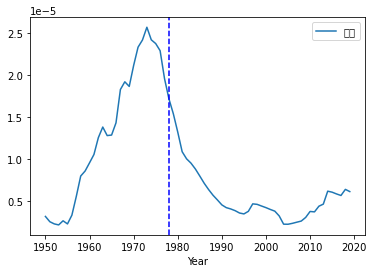

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 24110 (\N{CJK UNIFIED IDEOGRAPH-5E2E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21161 (\N{CJK UNIFIED IDEOGRAPH-52A9}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


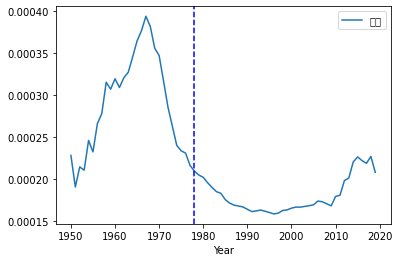

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 29306 (\N{CJK UNIFIED IDEOGRAPH-727A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 29298 (\N{CJK UNIFIED IDEOGRAPH-7272}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


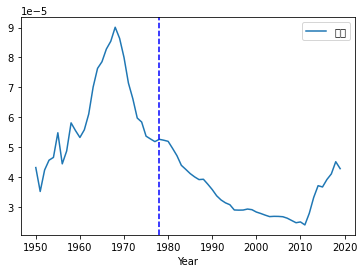

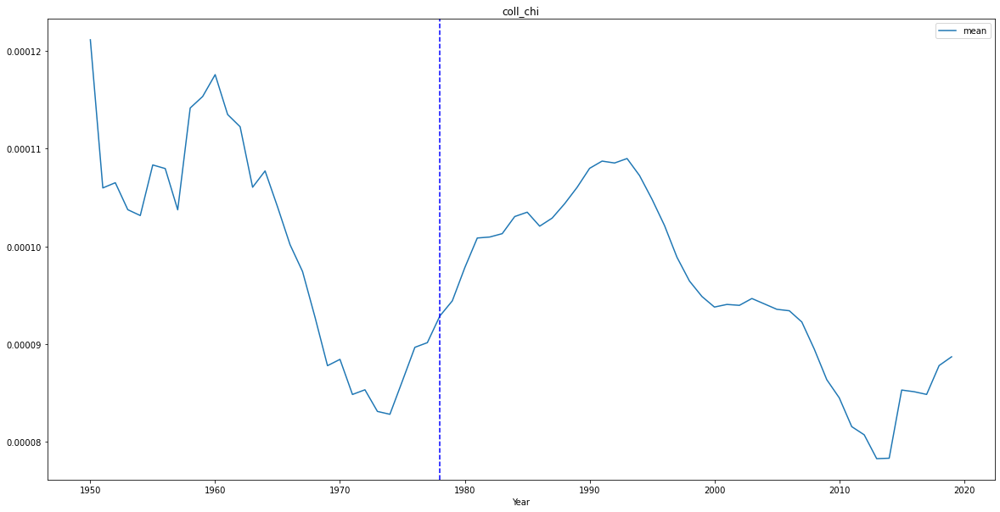

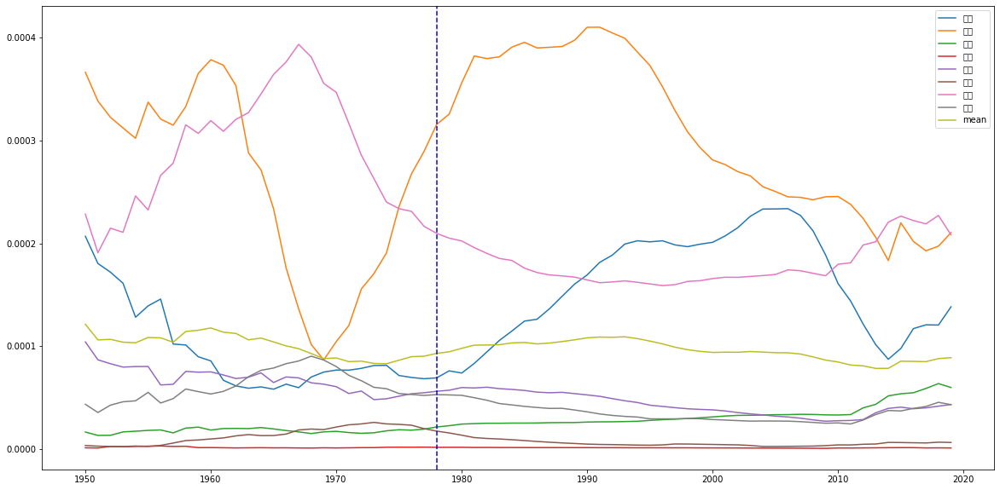

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 36873 (\N{CJK UNIFIED IDEOGRAPH-9009}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 25321 (\N{CJK UNIFIED IDEOGRAPH-62E9}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


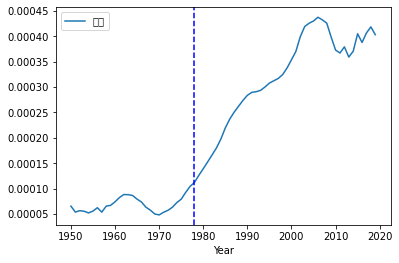

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 31454 (\N{CJK UNIFIED IDEOGRAPH-7ADE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20105 (\N{CJK UNIFIED IDEOGRAPH-4E89}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


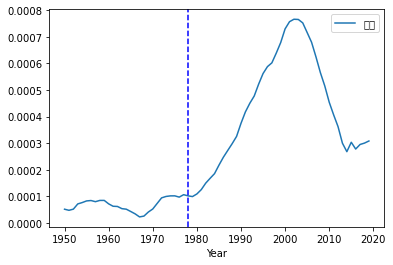

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 33719 (\N{CJK UNIFIED IDEOGRAPH-83B7}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21462 (\N{CJK UNIFIED IDEOGRAPH-53D6}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


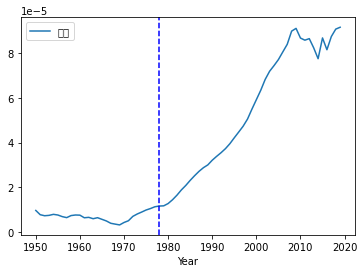

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 31169 (\N{CJK UNIFIED IDEOGRAPH-79C1}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


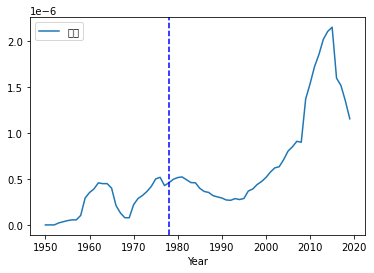

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 33258 (\N{CJK UNIFIED IDEOGRAPH-81EA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20027 (\N{CJK UNIFIED IDEOGRAPH-4E3B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


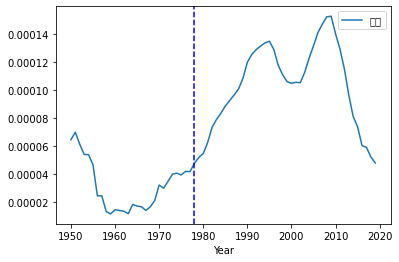

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22825 (\N{CJK UNIFIED IDEOGRAPH-5929}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 36171 (\N{CJK UNIFIED IDEOGRAPH-8D4B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


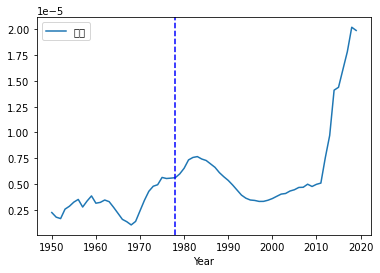

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21019 (\N{CJK UNIFIED IDEOGRAPH-521B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


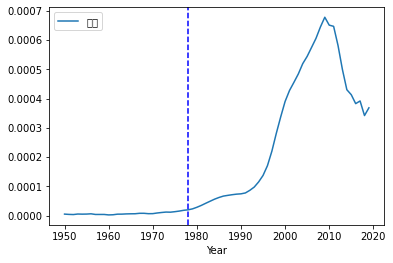

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 24179 (\N{CJK UNIFIED IDEOGRAPH-5E73}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


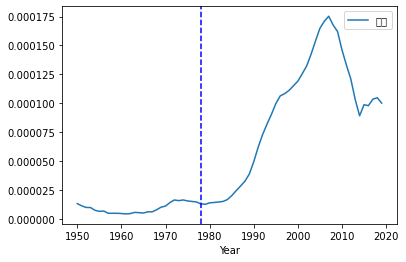

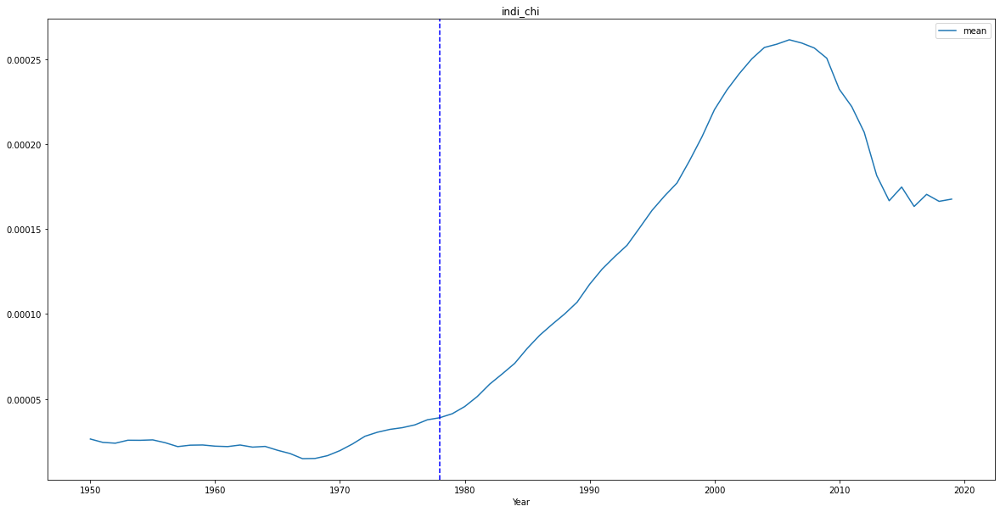

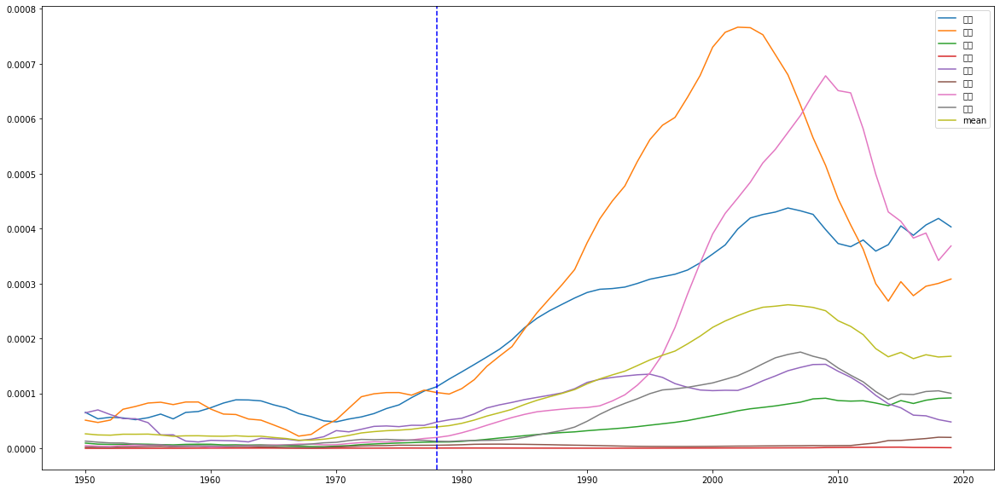

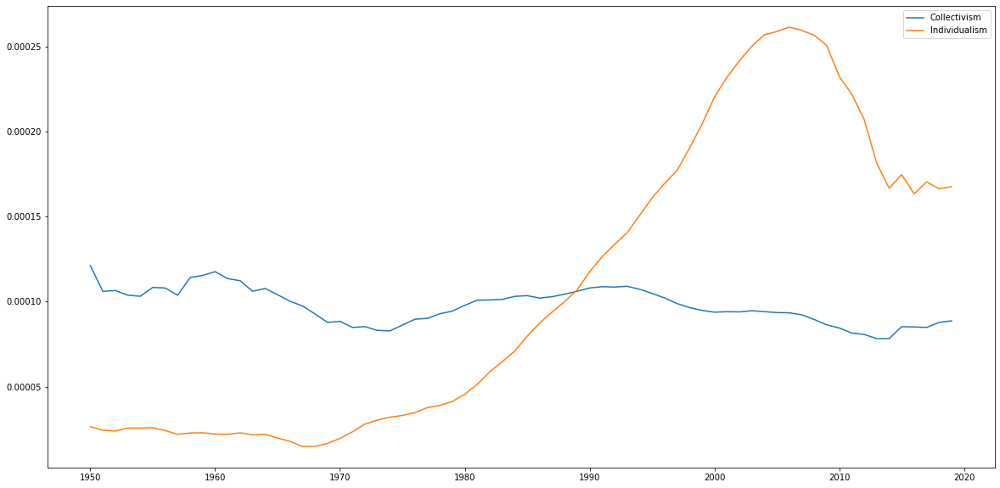

In [21]:
query = ",".join(dict_coll_chi)
dfcoll_chi = save_plot(query,[1978],'coll_chi',"ChiSim")

query = ",".join(dict_indi_chi)
dfindi_chi = save_plot(query,[1978],'indi_chi',"ChiSim")

plt.figure(figsize=(20,10))
plt.plot(dftight_chi['year'], dftight_chi['mean'],label = 'Collectivism')
plt.plot(dfloose_chi['year'], dfloose_chi['mean'],label = 'Individualism')
plt.legend()
plt.savefig(outputpath + 'CollIndi_chi.png')

In [ ]:
query = ",".join(dict_tight_chi)
dftight_chi = save_plot(query,[1978],'tight',"ChiSim")

query = ",".join(dict_loose_chi)
dfloose_chi = save_plot(query,[1978],'loose',"ChiSim")

plt.figure(figsize=(20,10))
plt.plot(dftight_chi['year'], dftight_chi['mean'],label = 'Tight')
plt.plot(dfloose_chi['year'], dfloose_chi['mean'],label = 'Loose')
plt.legend()
plt.savefig(outputpath + 'CollIndi_chi.png')

28


/tmp/ipykernel_936278/2238586400.py:78: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 10))


28
28
28


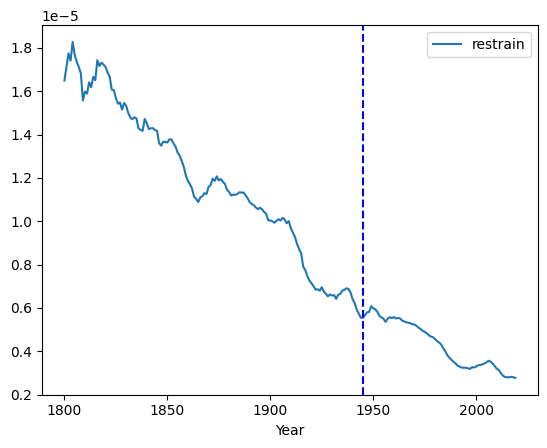

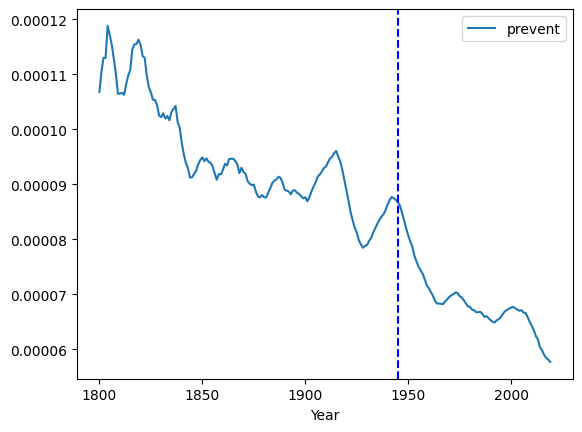

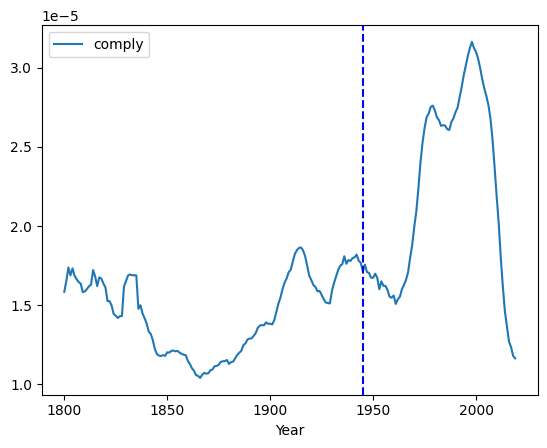

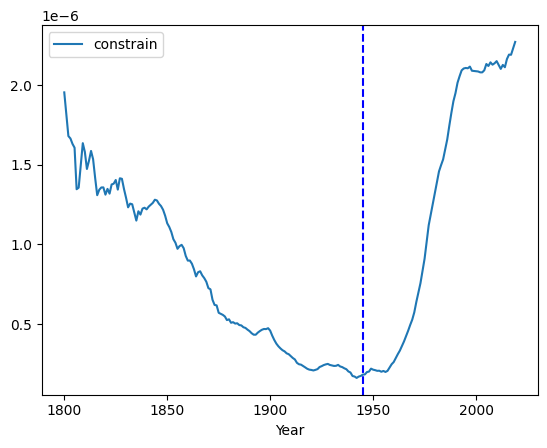

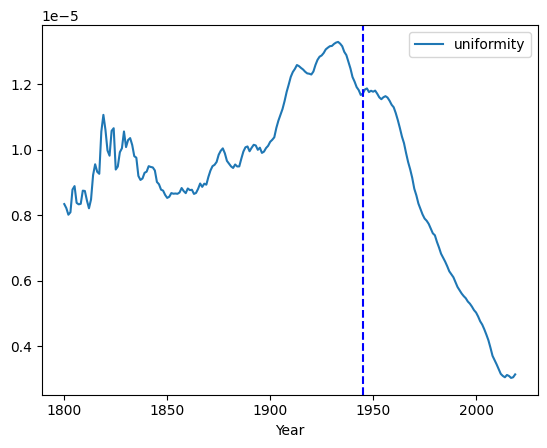

...

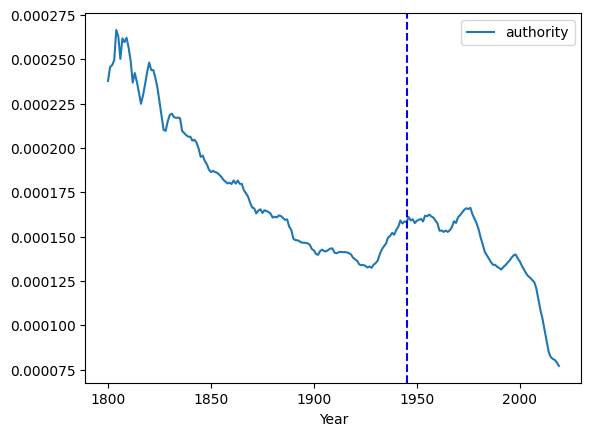

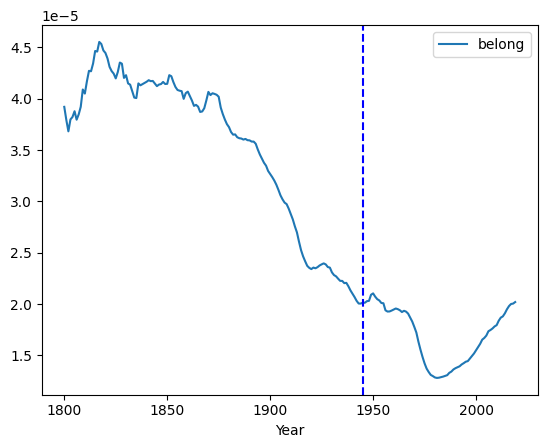

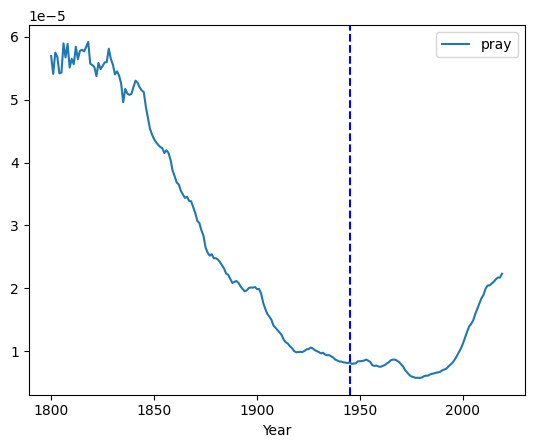

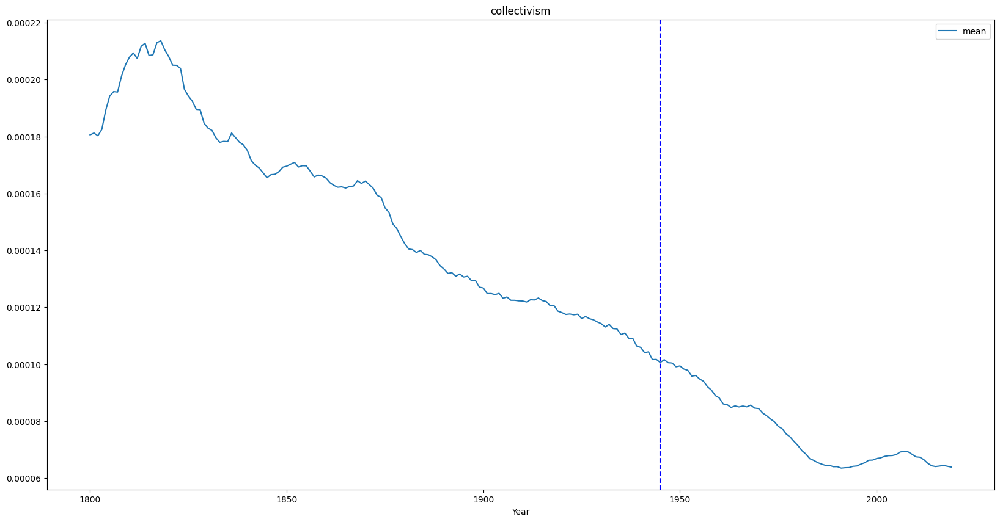

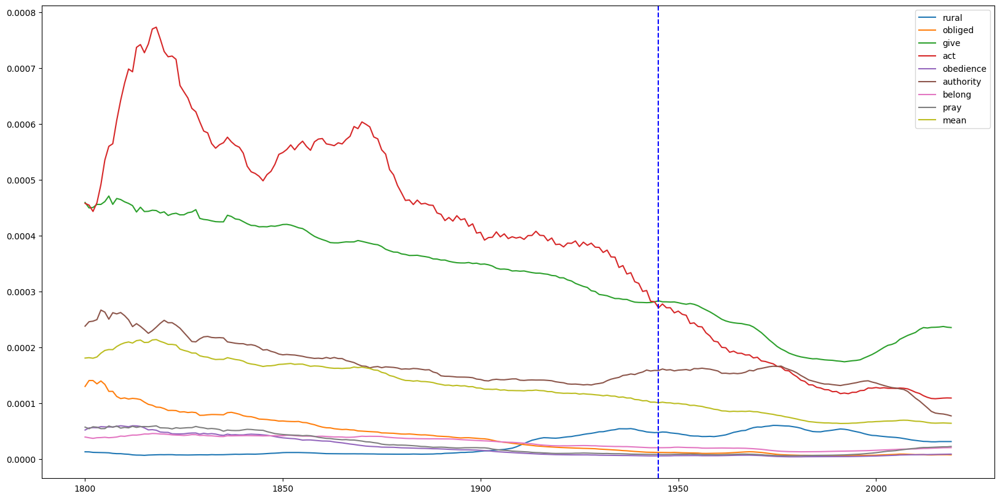

In [5]:
query = ",".join(dict_tight)
dftight = save_plot(query,[1945],'tight',"EngAme")

query = ",".join(dict_loose)
dfloose = save_plot(query,[1945],'loose',"EngAme")

query = ",".join(dict_indi)
dfindi = save_plot(query,[1945],'individualism',"EngAme")

query = ",".join(dict_coll)
dfcoll = save_plot(query,[1945],'collectivism',"EngAme")

# query = ",".join(dict_threat)
# dfthreat = save_plot(query,[1945],'threat',"EngAme")

28


/tmp/ipykernel_1059617/2238586400.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()
/tmp/ipykernel_1059617/2238586400.py:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[i[0]] = i[1]
/tmp/ipykernel_1059617/2238586400.py:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `ne

28


/tmp/ipykernel_1059617/2238586400.py:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[i[0]] = i[1]
/tmp/ipykernel_1059617/2238586400.py:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[i[0]] = i[1]
/tmp/ipykernel_1059617/2238586400.py:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[i[0]]

28


/tmp/ipykernel_1059617/2238586400.py:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[i[0]] = i[1]
/tmp/ipykernel_1059617/2238586400.py:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[i[0]] = i[1]
/tmp/ipykernel_1059617/2238586400.py:68: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[i[0]]

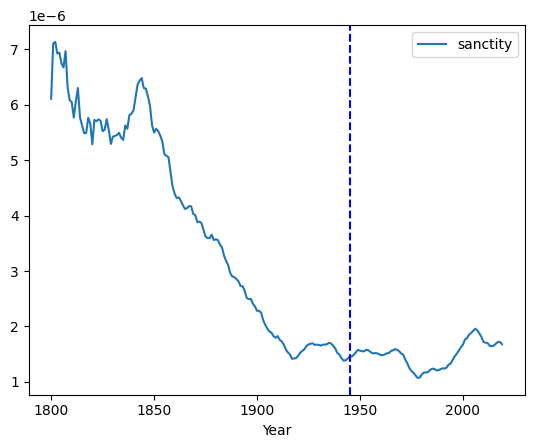

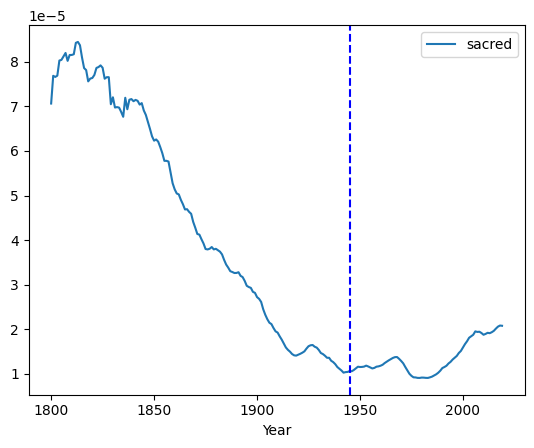

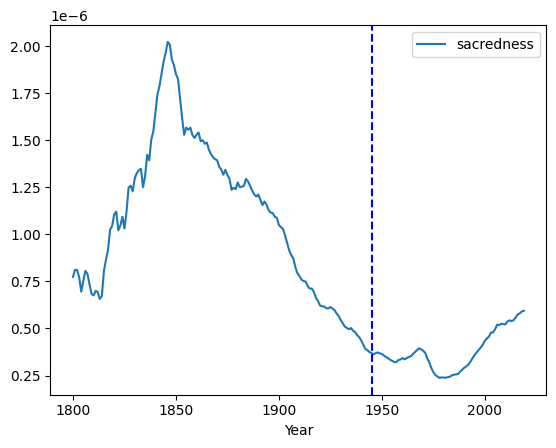

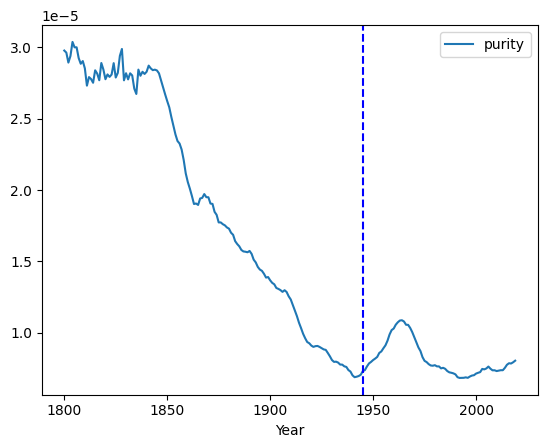

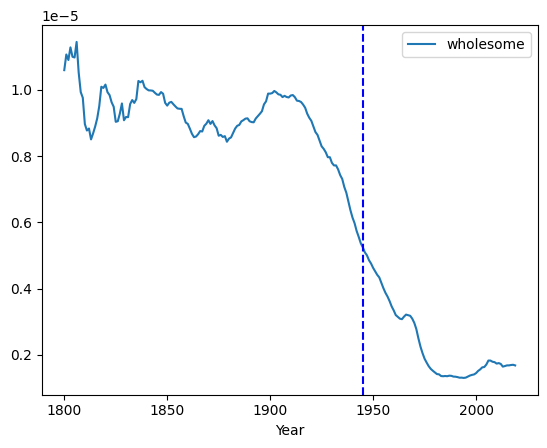

...

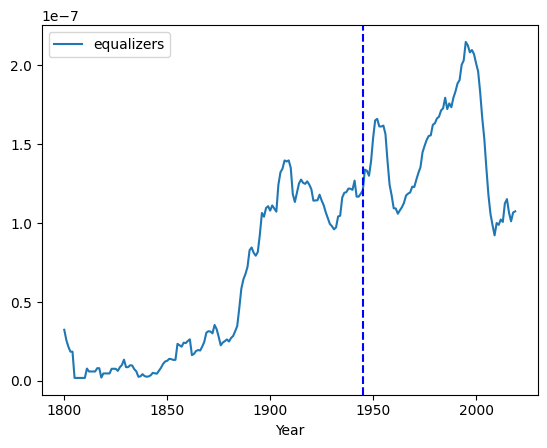

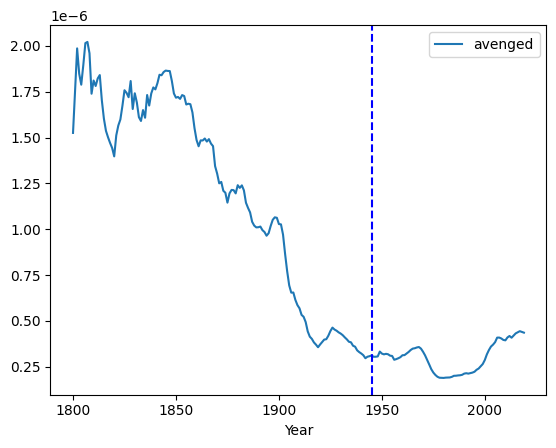

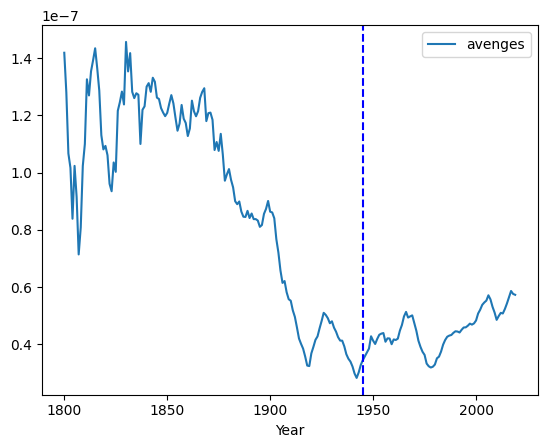

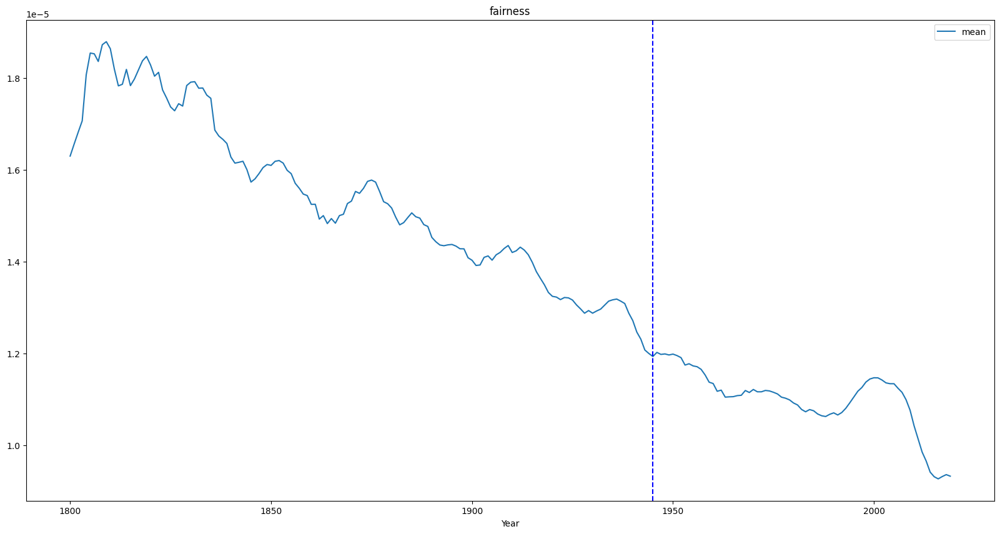

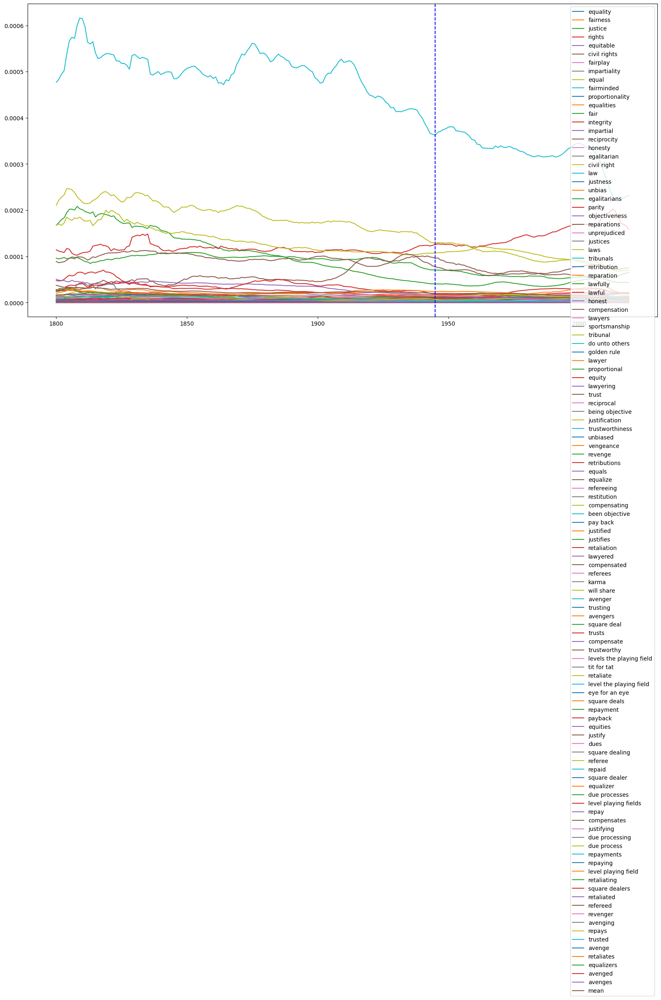

In [5]:
query = ",".join(sanc_vir)
dftight = save_plot(query,[1945],'sancity',"EngAme")

query = ",".join(loya_vir)
dfloose = save_plot(query,[1945],'loyalty',"EngAme")

query = ",".join(fare_vir)
dfindi = save_plot(query,[1945],'fairness',"EngAme")


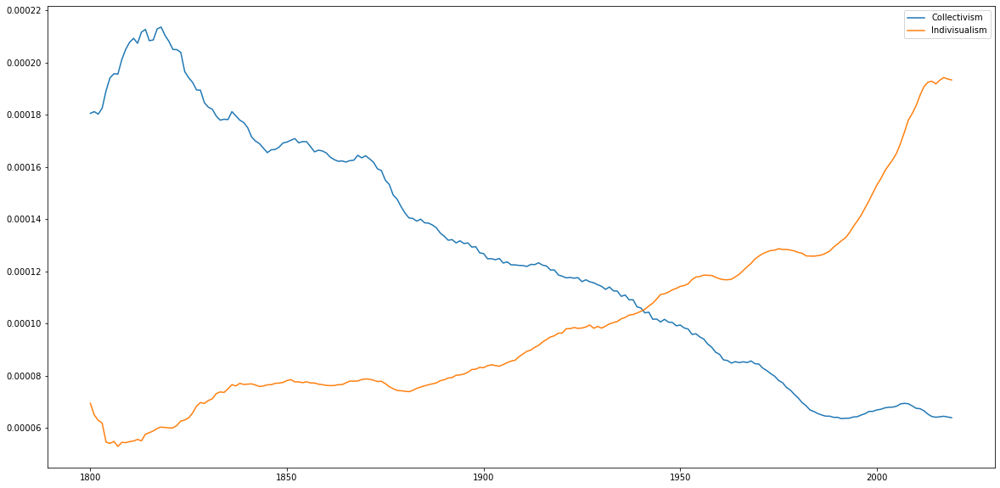

In [26]:
plt.figure(figsize=(20,10))
plt.plot(dftight['year'], dfcoll['mean'],label = 'Collectivism')
plt.plot(dftight['year'], dfindi['mean'],label = 'Indivisualism')
plt.legend()
plt.savefig(outputpath + 'CollIndi_EngAme.png')

In [18]:
# merge all dataframes's mean with dataframe names, dfindi,dfcoll,dfloose,dftight, into one, and save as csv
import os
dfcoll['coll'] = dfcoll['mean']
dfindi['indi'] = dfindi['mean']
dfloose['loose'] = dfloose['mean']
dftight['tight'] = dftight['mean']

dfall = pd.concat([dfcoll['year'], dfcoll['coll'],dfindi['indi'],dfloose['loose'],dftight['tight']],axis=1)
savepath = os.path.join(outputpath,'culturalvalues_EngAme.csv')
dfall.to_csv(savepath,index=False)



In [17]:
dfindi

,year,urban,choose,get,feel,individual,self,unique,child,mean,indi
0,1800,1.770809e-06,0.000036,0.000123,0.000097,0.000061,0.000096,0.000002,0.000138,0.000069,0.000069
1,1801,1.445735e-06,0.000036,0.000111,0.000092,0.000058,0.000091,0.000002,0.000128,0.000065,0.000065
2,1802,1.204779e-06,0.000038,0.000105,0.000090,0.000060,0.000086,0.000001,0.000121,0.000063,0.000063
3,1803,1.037777e-06,0.000038,0.000101,0.000092,0.000060,0.000085,0.000002,0.000117,0.000062,0.000062
4,1804,6.798256e-07,0.000038,0.000079,0.000085,0.000060,0.000077,0.000001,0.000095,0.000054,0.000054
...,...,...,...,...,...,...,...,...,...,...,...
215,2015,4.448660e-05,0.000062,0.000570,0.000210,0.000182,0.000218,0.000056,0.000193,0.000192,0.000192
216,2016,4.603366e-05,0.000061,0.000574,0.000216,0.000180,0.000221,0.000056,0.000193,0.000193,0.000193
217,2017,4.673438e-05,0.000061,0.000579,0.000219,0.000178,0.000222,0.000056,0.000193,0.000194,0.000194
218,2018,4.758624e-05,0.000060,0.000574,0.000219,0.000178,0.000225,0.000056,0.000190,0.000194,0.000194


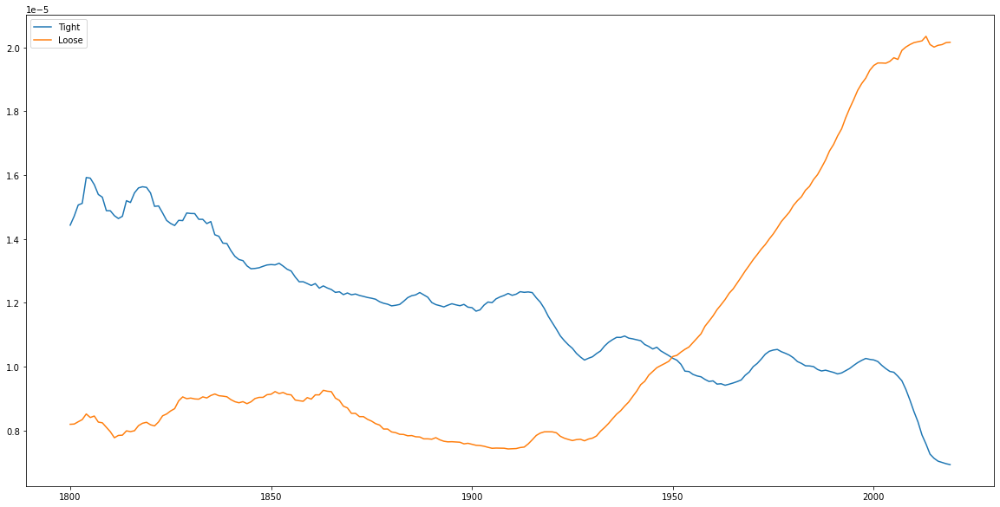

In [27]:
plt.figure(figsize=(20,10))
plt.plot(dftight['year'], dftight['mean'],label = 'Tight')
plt.plot(dftight['year'], dfloose['mean'],label = 'Loose')
plt.legend()
plt.savefig(outputpath + 'TightLoose_EngAme.png')

28
28


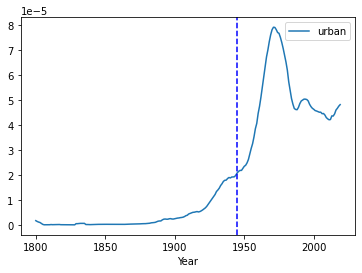

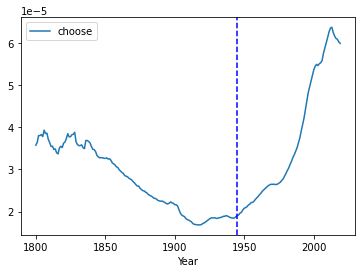

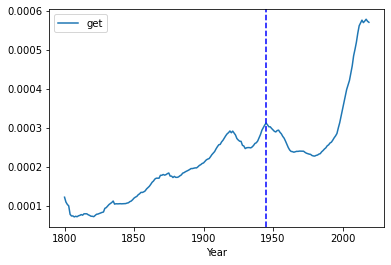

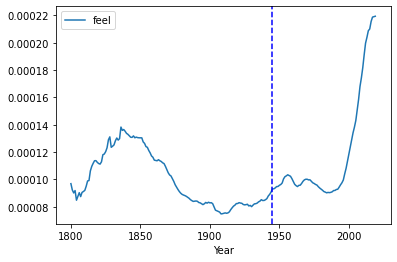

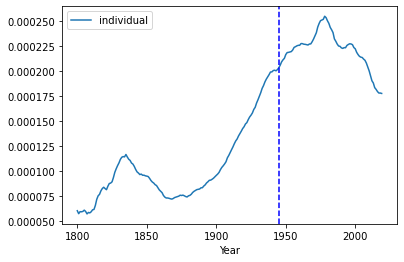

...

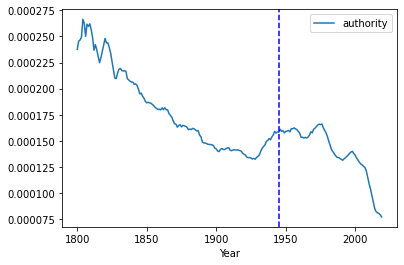

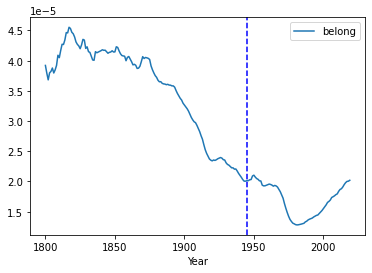

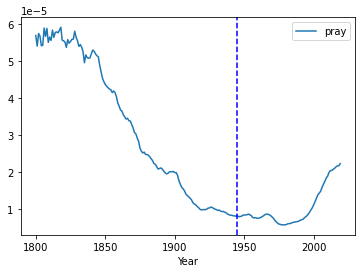

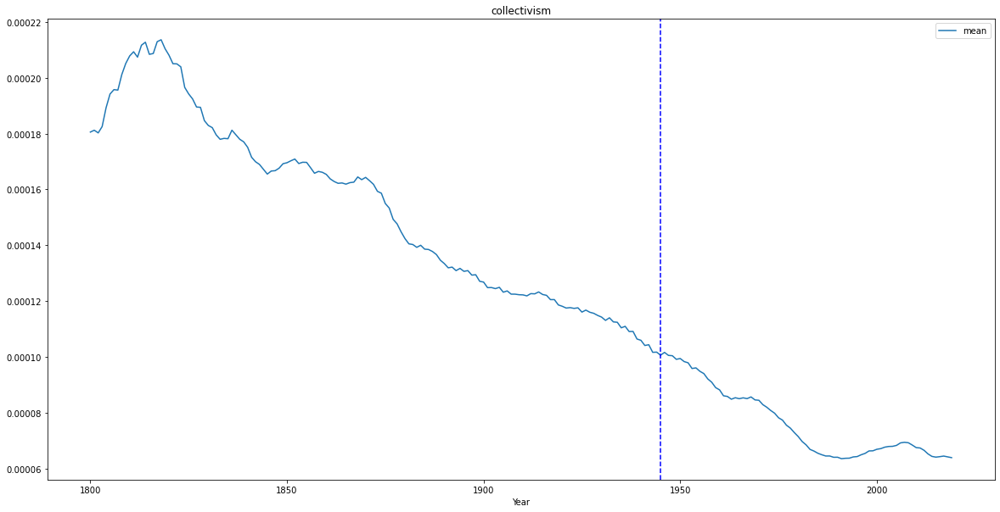

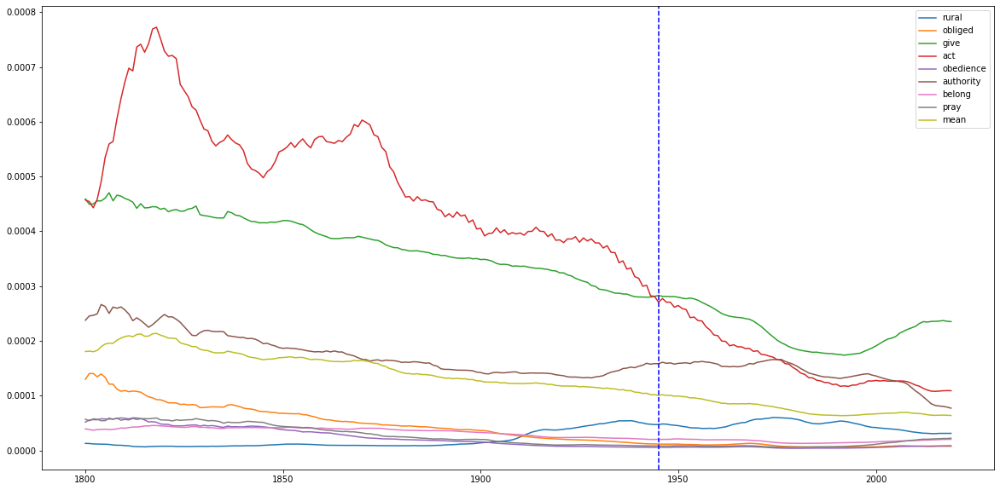

In [9]:
query = ",".join(dict_indi)
dfindi = save_plot(query,[1945],'individualism',"EngAme")

query = ",".join(dict_coll)
dfcoll = save_plot(query,[1945],'collectivism',"EngAme")

In [23]:
dfmerge = pd.DataFrame()
dfmerge['coll'] = dfcoll_chi['mean']
dfmerge['indi'] = dfindi_chi['mean']
dfmerge['tight'] = dftight_chi['mean']
dfmerge['loose'] = dfloose_chi['mean']
# dfmerge['threat'] = dfthreat_chi['mean']
dfmerge.to_csv(outputpath + 'prevalence_ChiSim.csv')

In [24]:
outputpath

'./NgramViewer/'

In [19]:
dfmerge.to_csv(outputpath + 'prevalence_EngAme.csv')

26
26


/tmp/ipykernel_1992939/2238586400.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


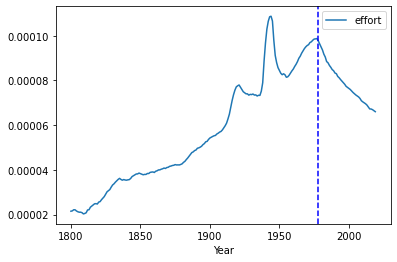

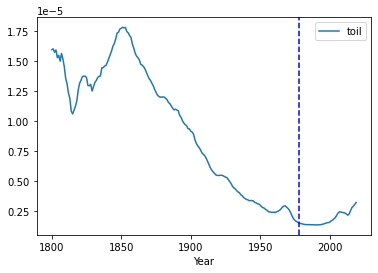

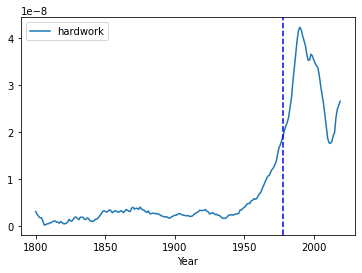

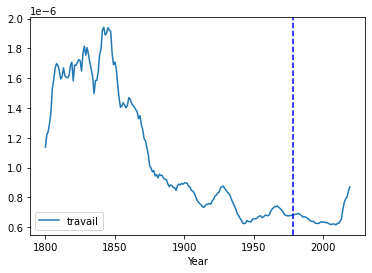

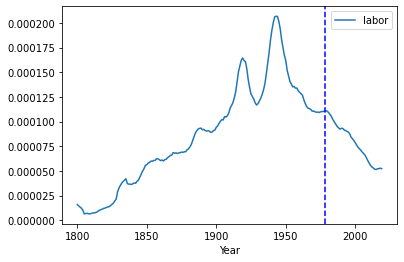

...

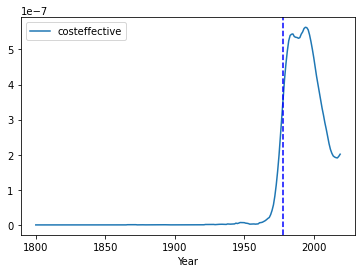

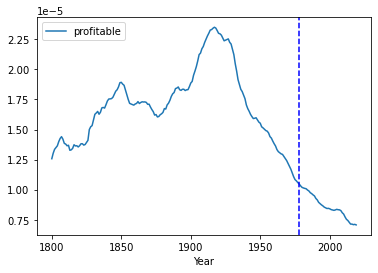

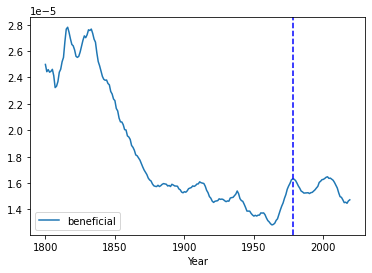

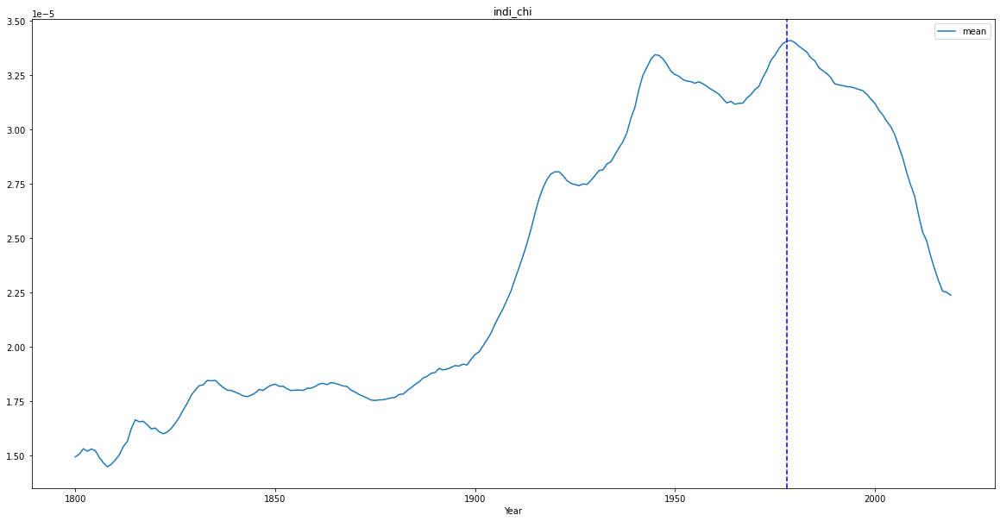

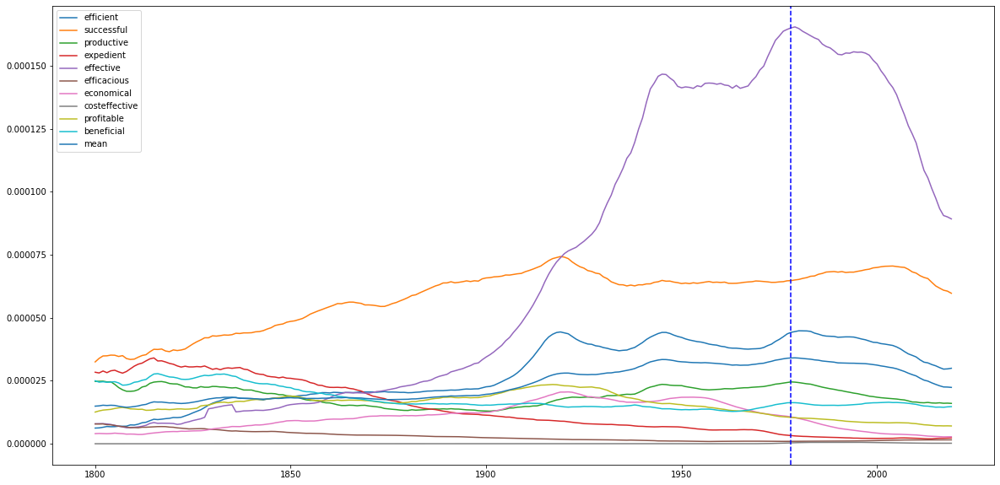

In [50]:
query = ",".join(dict_effort)
dfeffort = save_plot(query,[1978],'coll_chi',"AmeEng")

query = ",".join(dict_effici)
dfeffi = save_plot(query,[1978],'indi_chi',"AmeEng")



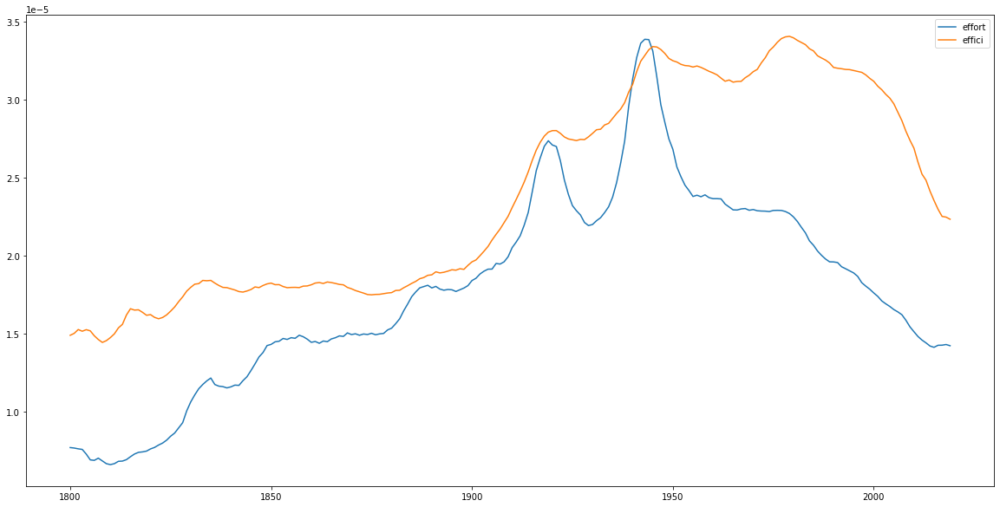

In [51]:
plt.figure(figsize=(20,10))
plt.plot(dfeffort['year'], dfeffort['mean'],label = "effort")
plt.plot(dfeffi['year'], dfeffi['mean'],label = 'effici')
plt.legend()
plt.savefig(outputpath + 'Eff_Eng_ngram.png')

34


/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 21162 (\N{CJK UNIFIED IDEOGRAPH-52AA}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 21147 (\N{CJK UNIFIED IDEOGRAPH-529B}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 21147 (\N{CJK UNIFIED IDEOGRAPH-529B}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 27714 (\N{CJK UNIFIED IDEOGRAPH-6C42}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 23613 (\N{CJK UNIFIED IDEOGRAPH-5C3D}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 21147 (\N{CJK UNIFIED IDEOGRAPH-529B}) missing from current font.
  plt.savefig(outputpath+i[0]

34


/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 25928 (\N{CJK UNIFIED IDEOGRAPH-6548}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 30410 (\N{CJK UNIFIED IDEOGRAPH-76CA}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 25928 (\N{CJK UNIFIED IDEOGRAPH-6548}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 29575 (\N{CJK UNIFIED IDEOGRAPH-7387}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 25928 (\N{CJK UNIFIED IDEOGRAPH-6548}) missing from current font.
  plt.savefig(outputpath+i[0]+'_freq.jpg')
/tmp/ipykernel_1992939/2238586400.py:76: UserWarning: Glyph 29992 (\N{CJK UNIFIED IDEOGRAPH-7528}) missing from current font.
  plt.savefig(outputpath+i[0]

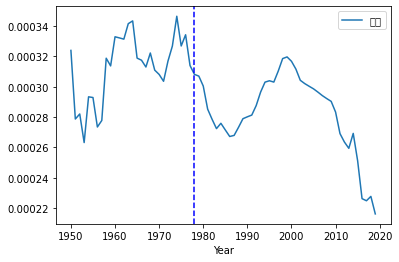

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27714 (\N{CJK UNIFIED IDEOGRAPH-6C42}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


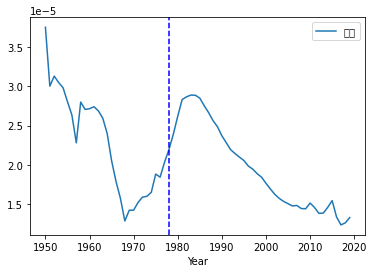

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 23613 (\N{CJK UNIFIED IDEOGRAPH-5C3D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


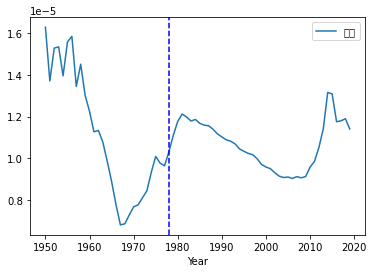

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21051 (\N{CJK UNIFIED IDEOGRAPH-523B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 33510 (\N{CJK UNIFIED IDEOGRAPH-82E6}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


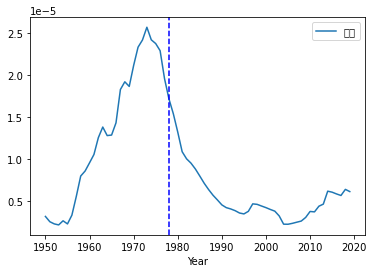

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22859 (\N{CJK UNIFIED IDEOGRAPH-594B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26007 (\N{CJK UNIFIED IDEOGRAPH-6597}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


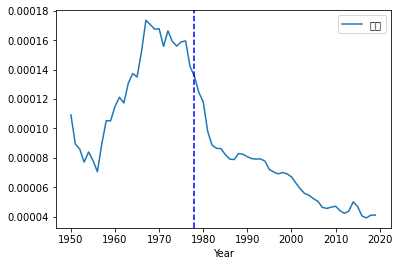

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20542 (\N{CJK UNIFIED IDEOGRAPH-503E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27880 (\N{CJK UNIFIED IDEOGRAPH-6CE8}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20840 (\N{CJK UNIFIED IDEOGRAPH-5168}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


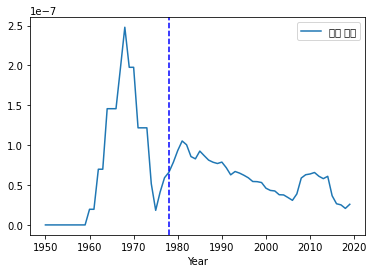

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20105 (\N{CJK UNIFIED IDEOGRAPH-4E89}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


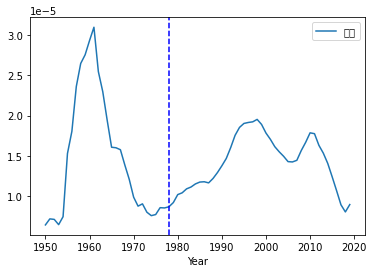

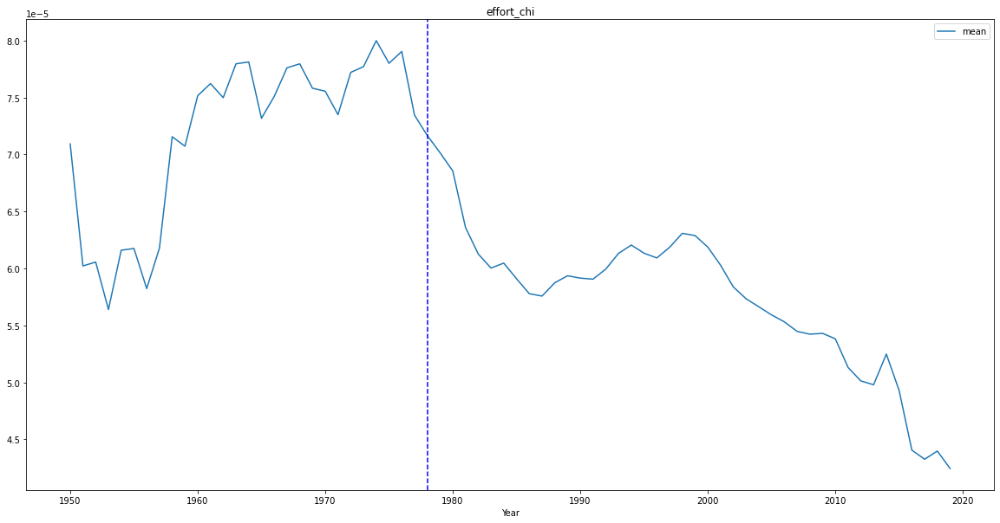

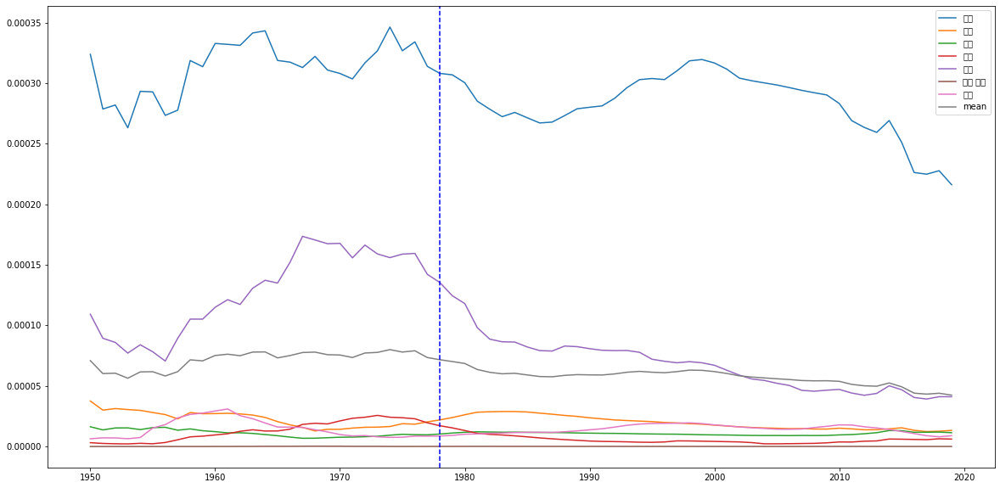

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 25928 (\N{CJK UNIFIED IDEOGRAPH-6548}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 30410 (\N{CJK UNIFIED IDEOGRAPH-76CA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


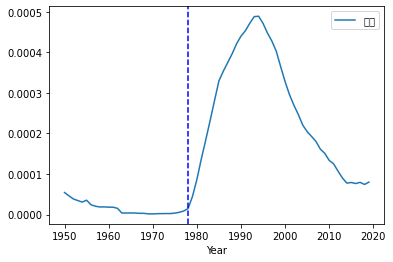

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 29575 (\N{CJK UNIFIED IDEOGRAPH-7387}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


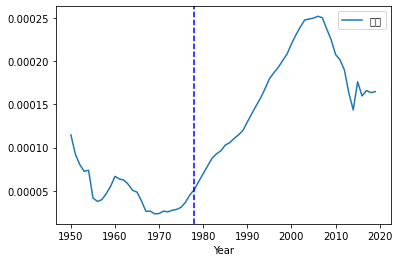

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 29992 (\N{CJK UNIFIED IDEOGRAPH-7528}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


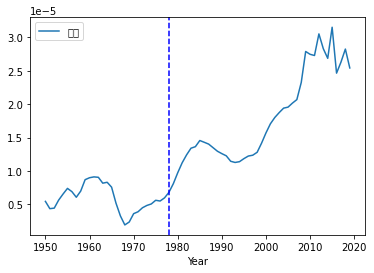

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 33021 (\N{CJK UNIFIED IDEOGRAPH-80FD}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


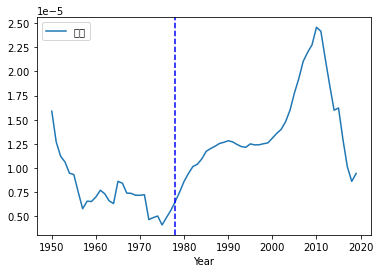

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26524 (\N{CJK UNIFIED IDEOGRAPH-679C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


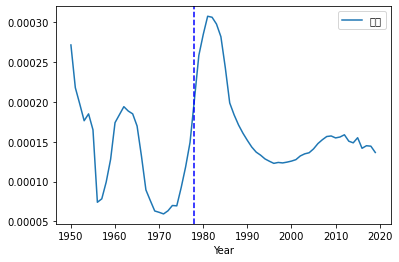

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 26368 (\N{CJK UNIFIED IDEOGRAPH-6700}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20248 (\N{CJK UNIFIED IDEOGRAPH-4F18}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21270 (\N{CJK UNIFIED IDEOGRAPH-5316}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


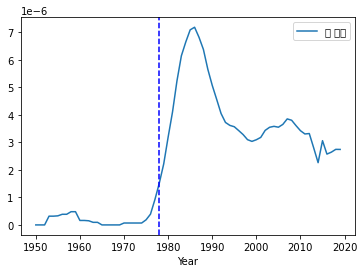

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20135 (\N{CJK UNIFIED IDEOGRAPH-4EA7}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20986 (\N{CJK UNIFIED IDEOGRAPH-51FA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


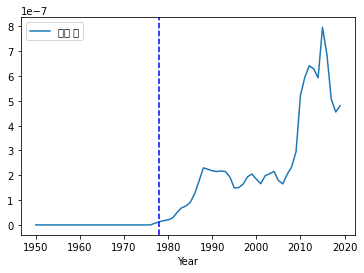

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21033 (\N{CJK UNIFIED IDEOGRAPH-5229}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


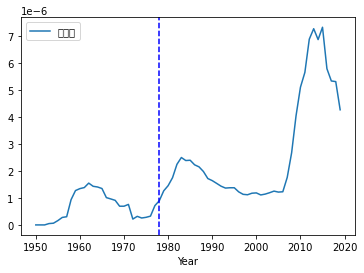

/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22686 (\N{CJK UNIFIED IDEOGRAPH-589E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20540 (\N{CJK UNIFIED IDEOGRAPH-503C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/local/PSYCH-ADS/xuqian_chen/anaconda3/envs/jupyter_env/envs/ngram/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 24615 (\N{CJK UNIFIED IDEOGRAPH-6027}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


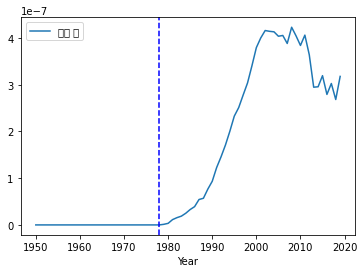

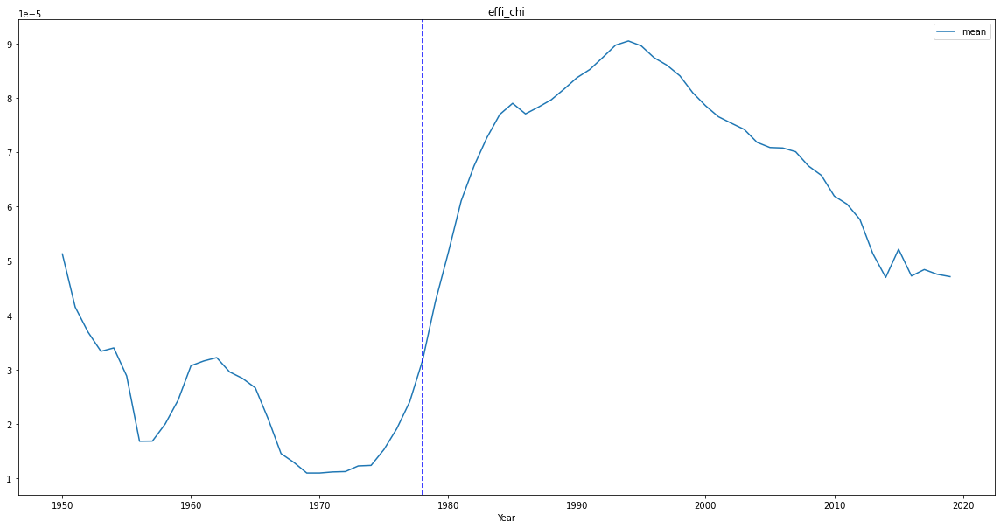

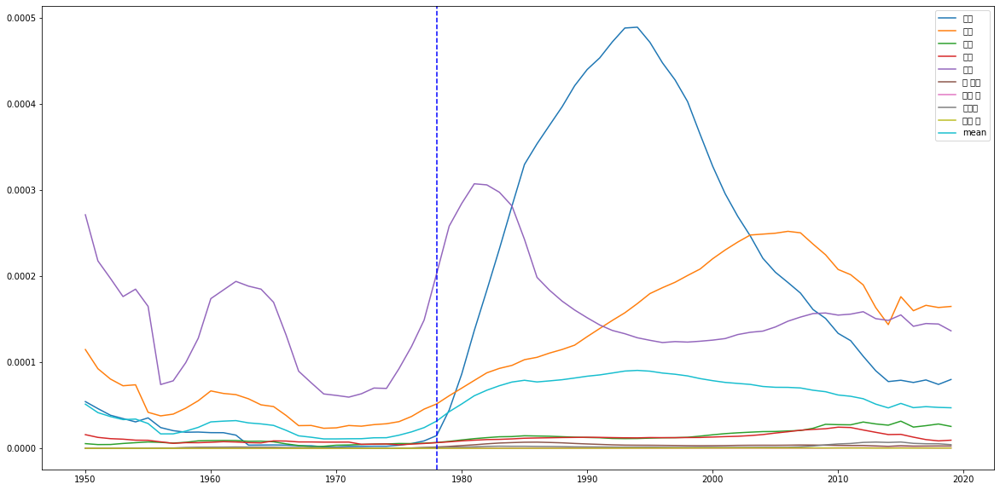

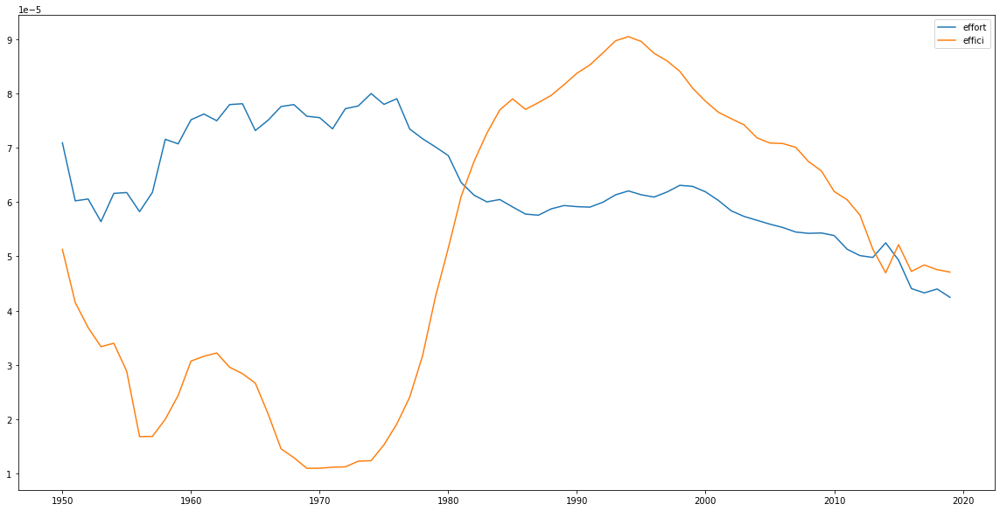

In [49]:
dict_effort_chi = '努力	力求	尽力	殚思竭虑	刻苦	奋斗	倾注全力	力争	始终不懈	孜孜不息'.split()
dict_effi_chi = '效益	效率	效用	效能	效果	最优化	产出率	节本降耗	利用率	增值性'.split()
query = ",".join(dict_effort_chi)
dfeffort = save_plot(query,[1978],'effort_chi',"ChiSim")

query = ",".join(dict_effi_chi)
dfeffi = save_plot(query,[1978],'effi_chi',"ChiSim")

plt.figure(figsize=(20,10))
plt.plot(dfeffort['year'], dfeffort['mean'],label = "effort")
plt.plot(dfeffi['year'], dfeffi['mean'],label = 'effici')
plt.legend()
plt.savefig(outputpath + 'Eff_Chi_ngram.png')

In [46]:
query

'试图,尽早,苦学,任劳任怨,极欲,坚守岗位,多层面,反封建,暴力手段,不懈努力,瞿贤军,第一线,刻苦耐劳,尽可能,妄想,起早摸黑,恐吓威胁,一骑当千,尽我所能,设法,勇于进取,强加于,深远影响,浴血战斗,地方保护主义,变革时代,以图,崇高目标,奢望,宏伟蓝图,二０一０,以求,方式及,可望,白辛苦,摸索,暂予,haciy,过日子,邪恶势力,太不容易,微操,科技战线,很累,肯吃苦,反分裂,拼搏,炮火连天,全力,永不言败,冀求,努力做到,角度观察,有望,战斗准备,产销,起早贪黑,成才,精益求精,另辟蹊径,非工会,钻劲,辛勤工作,艰辛,英勇斗争,宏伟目标,点钱,大兵团,努力完成,顽强拼搏,争权夺利,奋斗终生,革命斗争,耐劳,反动集团,季超,保卫祖国,极权,务求,神头岭,英勇,试一下,反台独,威胁要,以期,权力斗争,攻城战,正义斗争,秋补夏,勤奋努力,不断进步,条件成熟,战斗不止,追求幸福,永当,主题鲜明,极力,致力于,无怨无悔,资产阶级革命,内部矛盾,努力工作,争取,扩大开放,坚贞不渝,殚精竭力,愚蠢地,尽最大努力,奋斗不息,解决困难,勤苦,鼓足干劲,意在,没过几天,试水,欧元尽,驾轻就熟,细微处,开拓创新,好学不倦,蓄意,争斗,强加在,孜孜不倦,希望,一分耕耘一分收获,尽力去做,战斗行动,追求理想,rpg,最大限度,奋战,品性好,蒋爱国,虫族,体验性,胁迫,企图,意图,先河,死乞白赖,坚定不移,防御战,尽其所能,平衡力,反殖,艰苦奋斗,共同努力,竭尽所能,土崩瓦解,竭尽全力,归咎,向在,洒热血,斗争,勤奋,用功,按期,于如何,主体性,奋发努力,不疲倦,突出重点,非暴力,尝试性,来为其,团战,崇高理想,保守思想,思想斗争,有我无敌,既要,尽全力,篡夺,尊敬师长,力图,以免费,反侵略,武装斗争,竭力,激化,制止动乱,不拘一格,苦累,抗日救亡运动,攻坚战,自立自强,年普选,千方百计,乘隙,方式上,阴谋,锐意,恫吓,力所能及,一切办法,辛苦工作,熊猫起,幸苦,处心积虑,更臻,奋斗史,努力下去,尽力,小真,勤奋好学,核心理念,掌握本领,来试,向学,探索,劳碌,十三五,想尽办法,抱有幻想,逃路,重大斗争,福报,大胆,木有想,积极因素,整合营销,付出劳动,战斗,文化性,钻研,遭遇战,力求,强硬手段,长期不懈,竭尽心力,空战,项目计划,试一试,努力,修正主义,外来干涉,前期工作,一门心